## Kernel Density Estimation

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal
import cv2
import ast

In [16]:
# Import necessary libraries or modules

class KDE:
    def __init__(self, bandwidth=None, kernel='gaussian'):
        # Initialize the Kernel Density Estimation with bandwidth and kernel type
        self.bandwidth = bandwidth
        self.kernel_type = kernel
    
    def select_kernel(self, x):
        # Choose the specified kernel type for density estimation
        if self.kernel_type == 'gaussian':
            return self.gaussian_kernel(x)
        elif self.kernel_type == 'box':
            return self.box_kernel(x)
        elif self.kernel_type == 'triangle':
            return self.triangle_kernel(x)
        else:
            print("Kernel not found")

    def gaussian_kernel(self, x):
        # Gaussian kernel function for density estimation
        return multivariate_normal(mean=np.zeros(self.d), cov=np.eye(self.d)).pdf(x)
    
    def box_kernel(self, x):
        # Box kernel function for density estimation
        return np.prod(np.where(np.abs(x) <= 1, 1, 0), axis=1)
    
    def triangle_kernel(self, x):
        # Triangle kernel function for density estimation
        return np.prod(np.where(np.abs(x) <= 1, 1 - np.abs(x), 0), axis=1)

    def fit(self, X):
        # Fit the Kernel Density Estimation model to the given data
        self.X = X
        self.n = X.shape[0]
        self.d = X.shape[1]
        self.data = X
        self.bandwidth = self._find_bandwidth(X)

    def density(self, x):
        # Estimate the density at a given point using the selected kernel
        h = self.bandwidth
        val = np.sum(self.select_kernel((self.X - x) / h))
        val = val / (self.n * (h**self.d))
        return val
    
    def visualize(self):
        # Visualize the estimated density for 1D or 2D data
        if self.d == 1:
            x_grid = np.linspace(self.data.min() - 1, self.data.max() + 1, 1000)
            pdf = np.array([self.density(point) for point in x_grid[:, None]])
            threshold = x_grid[np.argmax(pdf)]
            plt.plot(x_grid, pdf)
            plt.scatter(self.data, np.zeros_like(self.data), marker='.')
            plt.axvline(threshold, color='red', linestyle='dashed', label='Threshold')
            plt.show()
            return threshold
        elif self.d == 2:
            x, y = np.mgrid[self.data[:,0].min():self.data[:,0].max():100j, self.data[:,1].min():self.data[:,1].max():100j]
            positions = np.vstack([x.ravel(), y.ravel()]).T
            densities = np.array([self.density(point) for point in positions])
            pdf = np.reshape(densities, x.shape)
            plt.contourf(x, y, pdf, cmap='Blues')
            plt.scatter(self.data[:,0], self.data[:,1], c='red')
            plt.colorbar()
            plt.show()
        else:
            print("Visualization not supported for more than 2 dimensions")

    def pseudo_likelihood(self, h, data):
        # Calculate pseudo-likelihood for bandwidth selection
        likelihoods = []
        for i in range(self.n):
            # Leave-one-out cross-validation
            leave_one_out = np.concatenate([data[:i], data[i+1:]])
            kernels = self.select_kernel((leave_one_out - data[i]) / h)
            likelihood = np.sum(kernels) / ((self.n - 1) * h)
            likelihoods.append(np.log(likelihood + 1e-10))
        return np.sum(likelihoods)
    
    def _find_bandwidth(self, data):
        # Find bandwidth using pseudo-likelihood cross-validation
        if self.bandwidth:
            return self.bandwidth
        min_bandwidth = max(np.std(data) * (self.n ** (-1/5)), 1e-1)
        k = self.n * self.d // 4
        bandwidths = np.linspace(min_bandwidth, max(4 * np.std(data), 1.0), 100) 

        likelihoods = [self.pseudo_likelihood(h, data) for h in bandwidths]
        return bandwidths[np.argmax(likelihoods)]

(1000, 1)


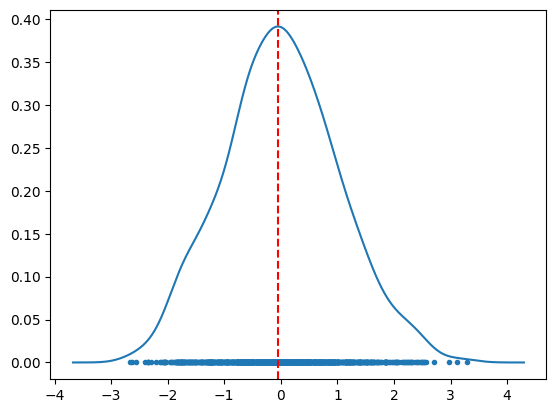

-0.051233143958716365


In [17]:
data = np.random.normal(size=(1000, 1))  # Generating some 1-D data
kde = KDE()
print(data.shape)
kde.fit(data)
print(kde.visualize())

(1000, 2)


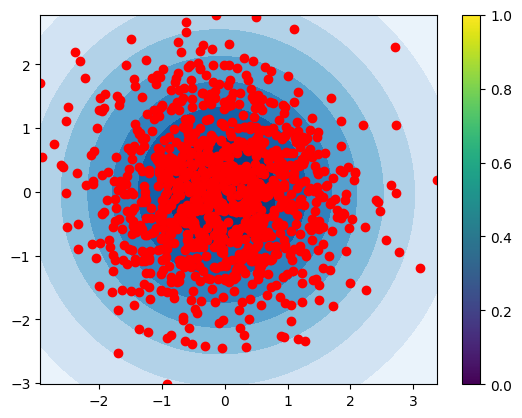

None


In [19]:
data = np.random.normal(size=(1000, 2))  # Generating some 2-D data
kde = KDE()
print(data.shape)
kde.fit(data)
print(kde.visualize())

In [20]:
def read_data(file):
    data = pd.read_csv(file)
    data["Top-Left"] = data["Top-Left"].apply(ast.literal_eval)
    data["Bottom-Right"] = data["Bottom-Right"].apply(ast.literal_eval)
    data["Top"] = data.apply(lambda row: [(row["Top-Left"][0] + row["Bottom-Right"][0]) / 2, row["Top-Left"][1]], axis=1)
    data["Bottom"] = data.apply(lambda row: [(row["Top-Left"][0] + row["Bottom-Right"][0]) / 2, row["Bottom-Right"][1]], axis=1)
    data["Right"] = data.apply(lambda row: [row["Bottom-Right"][0], (row["Top-Left"][1] + row["Bottom-Right"][1]) / 2], axis=1)
    data["Left"] = data.apply(lambda row: [row["Top-Left"][0], (row["Top-Left"][1] + row["Bottom-Right"][1]) / 2], axis=1)
    data["Mid"] = data.apply(lambda row: [(row["Top-Left"][0] + row["Bottom-Right"][0]) / 2, (row["Top-Left"][1] + row["Bottom-Right"][1]) / 2], axis=1)
    return data

def calc_distances(df):
    horizontal_dist = []
    vertical_dist = []

    for idx1, row1 in df.iterrows():
        hor = 10000000.00
        ver = 10000000.00
        for idx2, row2 in df.iterrows():
            if(idx1!=idx2):
                # calculate horizontal distance
                top_left1 = row1['Top-Left']
                bottom_right1 = row1['Bottom-Right']

                top_left2 = row2['Top-Left']
                bottom_right2 = row2['Bottom-Right']

                top_left1 = np.array(top_left1)
                bottom_right1 = np.array(bottom_right1)

                top_left2 = np.array(top_left2)
                bottom_right2 = np.array(bottom_right2)
                
                top_center1 = [(top_left1[0]+bottom_right1[0])/2, top_left1[1]]
                top_center2 = [(top_left2[0]+bottom_right2[0])/2, top_left2[1]]
                bottom_center1 = [(top_left1[0]+bottom_right1[0])/2, bottom_right1[1]]
                bottom_center2 = [(top_left2[0]+bottom_right2[0])/2, bottom_right2[1]]
                right_center1 = [bottom_right1[0], (top_left1[1]+bottom_right1[1])/2]
                right_center2 = [bottom_right2[0], (top_left2[1]+bottom_right2[1])/2]
                left_center1 = [top_left1[0], (top_left1[1]+bottom_right1[1])/2]
                left_center2 = [top_left2[0], (top_left2[1]+bottom_right2[1])/2]

                top_center1 = np.array(top_center1)
                top_center2 = np.array(top_center2)
                bottom_center1 = np.array(bottom_center1)
                bottom_center2 = np.array(bottom_center2)
                right_center1 = np.array(right_center1)
                right_center2 = np.array(right_center2)
                left_center1 = np.array(left_center1)
                left_center2 = np.array(left_center2)

                if(top_center1[1] > top_center2[1]):
                    dist = np.sqrt(np.sum((top_center1-bottom_center2)**2))
                    # print(dist)
                    ver = min(dist, ver)
                else:
                    dist = np.sqrt(np.sum((top_center2-bottom_center1)**2))
                    ver = min(dist, ver)

                if(right_center1[0] > right_center2[0]):
                    dist = np.sqrt(np.sum((right_center1-left_center2)**2))
                    hor = min(dist, hor)
                else:
                    dist = np.sqrt(np.sum((right_center2-left_center1)**2))
                    hor = min(dist, hor)
        horizontal_dist.append(hor)
        vertical_dist.append(ver)

    return np.array(horizontal_dist), np.array(vertical_dist)

def threshold(distances, bandwidth= None):
    kde = KDE(bandwidth= bandwidth)
    kde.fit(np.array(distances))
    return kde.visualize()

def update_connections(df, horizontal_threshold, vertical_threshold):
    df['Top_Box'] = [[-1, 0]] * len(df)
    df['Bottom_Box'] = [[-1, 0]] * len(df)
    df['Left_Box'] = [[-1, 0]] * len(df)
    df['Right_Box'] = [[-1, 0]] * len(df)

    for index, row in df.iterrows():
        min_top_dist = vertical_threshold + 1
        min_bottom_dist = vertical_threshold + 1
        min_left_dist = horizontal_threshold + 1
        min_right_dist = horizontal_threshold + 1

        top_box_id = -1
        bottom_box_id = -1
        left_box_id = -1
        right_box_id = -1

        top_left = row['Top-Left']
        bottom_right = row['Bottom-Right']

        center_x = (top_left[0] + bottom_right[0]) / 2
        center_y = (top_left[1] + bottom_right[1]) / 2

        for index2, row2 in df.iterrows():
            if index2 != index:
                top_left2 = row2['Top-Left']
                bottom_right2 = row2['Bottom-Right']

                center2_x = (top_left2[0] + bottom_right2[0]) / 2
                center2_y = (top_left2[1] + bottom_right2[1]) / 2

                distance_x = abs(center_x - center2_x)
                distance_y = abs(center_y - center2_y)

                if distance_x <= horizontal_threshold:
                    if center2_y < center_y and distance_y < min_top_dist:  
                        min_top_dist = distance_y
                        top_box_id = row2['Id']
                    elif center2_y > center_y and distance_y < min_bottom_dist:  
                        min_bottom_dist = distance_y
                        bottom_box_id = row2['Id']

                if distance_y <= vertical_threshold:
                    if center2_x < center_x and distance_x < min_left_dist: 
                        min_left_dist = distance_x
                        left_box_id = row2['Id']
                    elif center2_x > center_x and distance_x < min_right_dist: 
                        min_right_dist = distance_x
                        right_box_id = row2['Id']

        df.at[index, 'Top_Box'] = [min_top_dist, top_box_id] if top_box_id != -1 else [-1, 0]
        df.at[index, 'Bottom_Box'] = [min_bottom_dist, bottom_box_id] if bottom_box_id != -1 else [-1, 0]
        df.at[index, 'Left_Box'] = [min_left_dist, left_box_id] if left_box_id != -1 else [-1, 0]
        df.at[index, 'Right_Box'] = [min_right_dist, right_box_id] if right_box_id != -1 else [-1, 0]

    return df

In [7]:
def visualize_bboxes(img, df):
    img_2 = img.copy()
    for index, row in df.iterrows():
        top_left = tuple(row['Top-Left'])
        bottom_right = tuple(row['Bottom-Right'])
        cv2.rectangle(img_2, top_left, bottom_right, (255, 0, 0), 2)
    plt.figure(figsize=(25, 8))
    
    plt.imshow(img_2)
    plt.show()
    
def make_connections(image, euclidean):

  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  image_with_boxes = image_rgb.copy()

  for index, row in euclidean.iterrows():
      left = int(row['Left'][0])
      right = int(row['Right'][0])
      top = int(row['Top'][1])
      bottom = int(row['Bottom'][1])
      box_id = int(row['Id'])

      width = right - left
      height = bottom - top

      top_left = (left, top)
      bottom_right = (right, bottom)

      cv2.rectangle(image_with_boxes, top_left, bottom_right, (255, 0, 0), 2)

      label_position = (left, top - 10)
      cv2.putText(image_with_boxes, str(box_id), label_position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)

      top_adjacent_id = int(row['Top_Box'][1])
      bottom_adjacent_id = int(row['Bottom_Box'][1])
      left_adjacent_id = int(row['Left_Box'][1])
      right_adjacent_id = int(row['Right_Box'][1])

      if top_adjacent_id != 0:
          top_adjacent_row = euclidean[euclidean['Id'] == top_adjacent_id].iloc[0]
          top_adjacent_center = int(top_adjacent_row['Bottom'][0]) , int(top_adjacent_row['Bottom'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(top)), top_adjacent_center, (0, 255, 0), 2)

      if bottom_adjacent_id != 0:
          bottom_adjacent_row = euclidean[euclidean['Id'] == bottom_adjacent_id].iloc[0]
          bottom_adjacent_center = int(bottom_adjacent_row['Top'][0]) , int(bottom_adjacent_row['Top'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(bottom)), (int(bottom_adjacent_center[0]), int(bottom_adjacent_center[1])), (0, 255, 0), 2)

      if left_adjacent_id != 0:
          left_adjacent_row = euclidean[euclidean['Id'] == left_adjacent_id].iloc[0]
          left_adjacent_center = int(left_adjacent_row['Right'][0]) , int(left_adjacent_row['Right'][1])
          cv2.line(image_with_boxes, (int(left), int(top) + height // 2), (int(left_adjacent_center[0]), int(left_adjacent_center[1])), (0, 255, 0), 2)

      if right_adjacent_id != 0:
          right_adjacent_row = euclidean[euclidean['Id'] == right_adjacent_id].iloc[0]
          right_adjacent_center = int(right_adjacent_row['Left'][0]) , int(right_adjacent_row['Left'][1])
          cv2.line(image_with_boxes, (int(right), int(top) + height // 2), (int(right_adjacent_center[0]), int(right_adjacent_center[1])), (0, 255, 0), 2)

  return image_with_boxes

File ID:  29
Bandwidth Value:  None


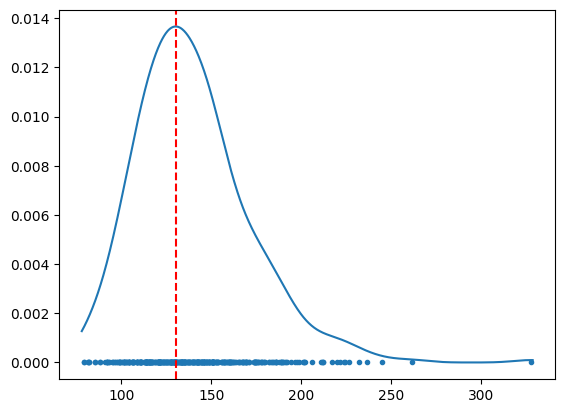

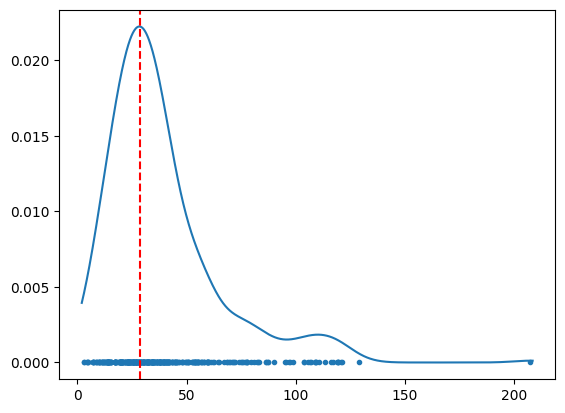

Horizontal Threshold:  130.17516520513055
Vertical Threshold:  28.44664643474431


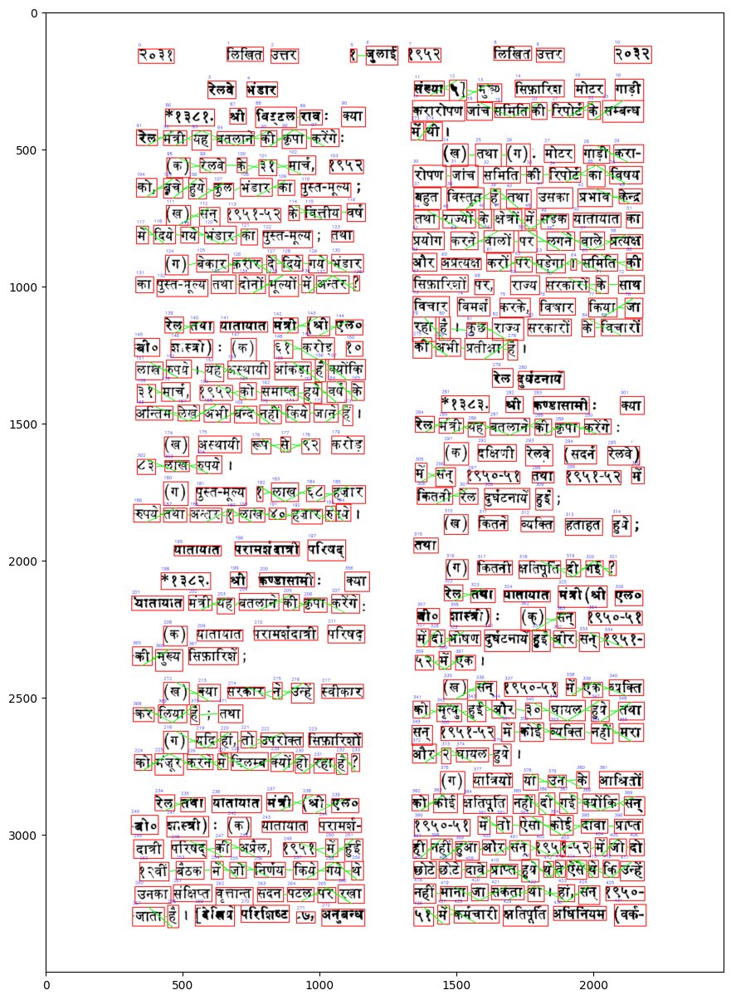

File ID:  29
Bandwidth Value:  1000


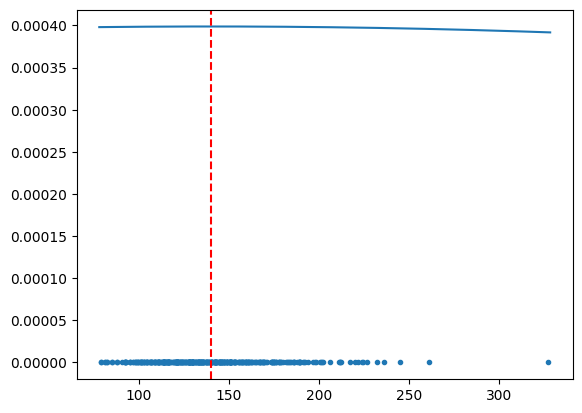

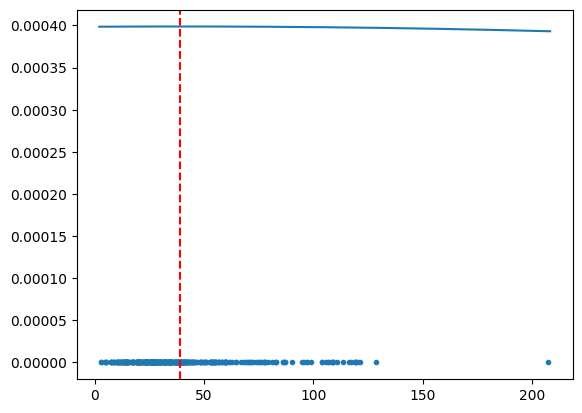

Horizontal Threshold:  139.95326260599475
Vertical Threshold:  38.777367698316304


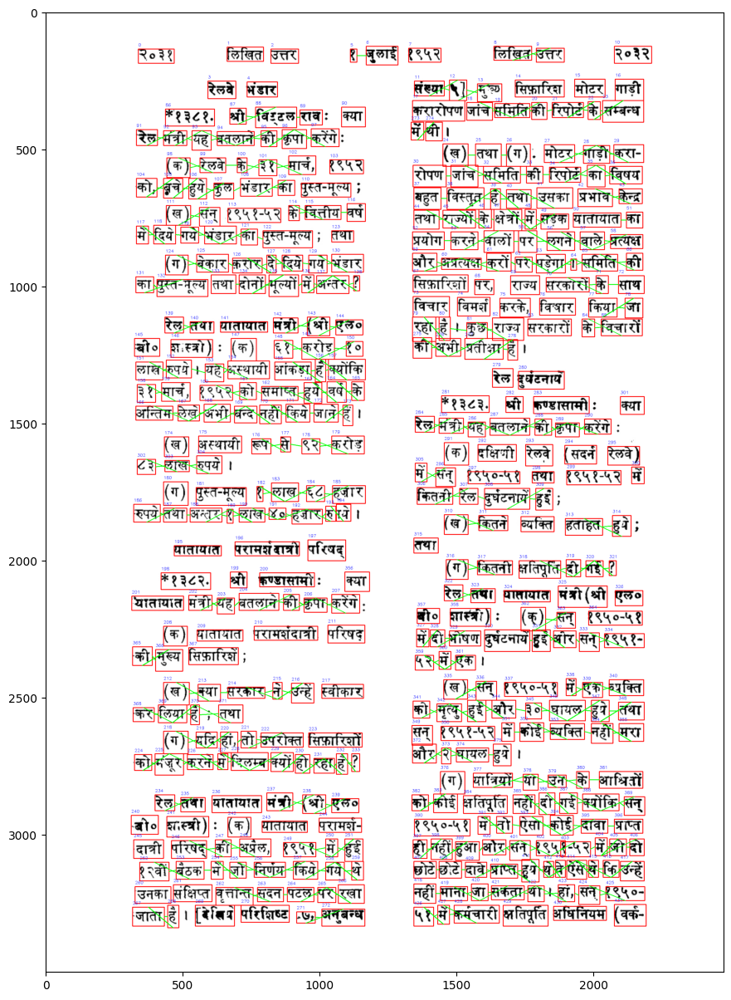

File ID:  29
Bandwidth Value:  10


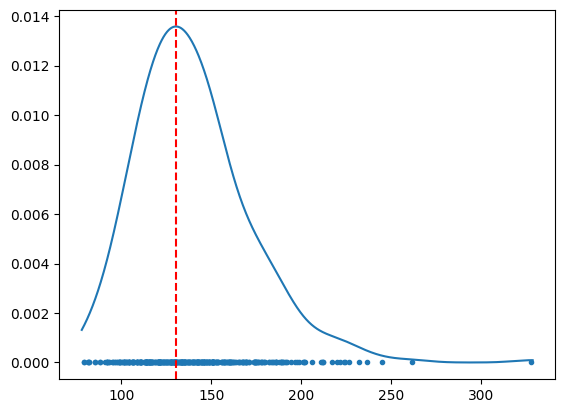

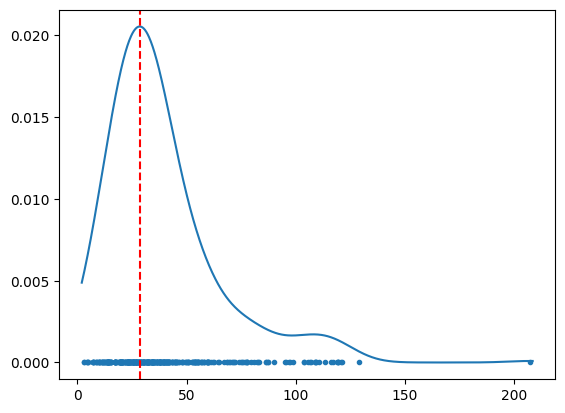

Horizontal Threshold:  130.42588565130654
Vertical Threshold:  28.44664643474431


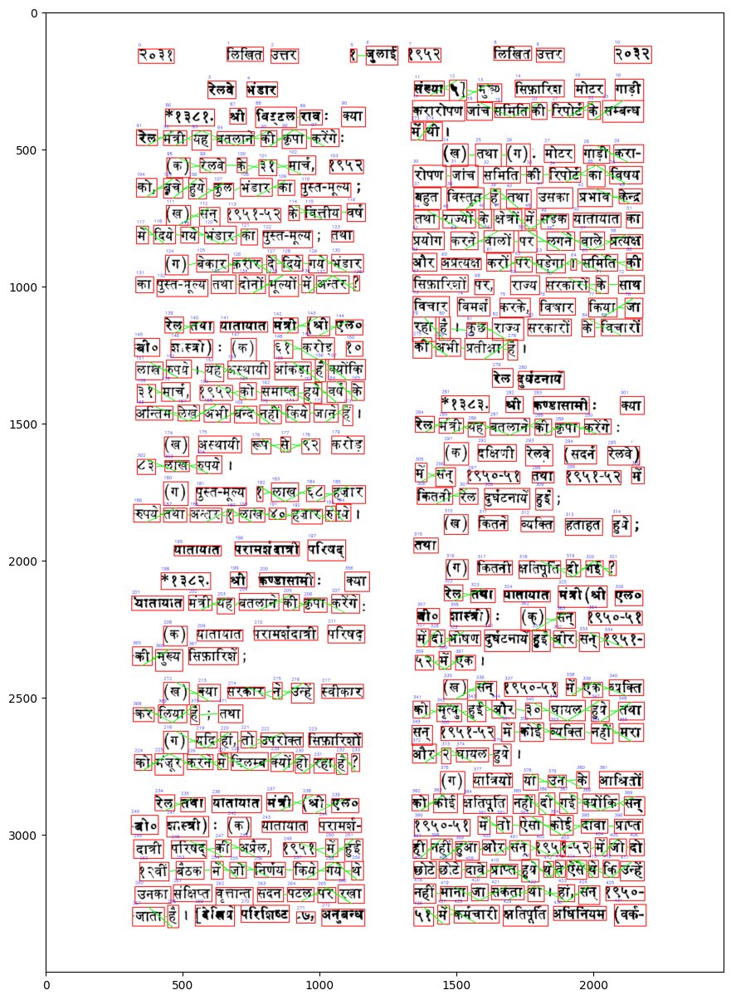

File ID:  29
Bandwidth Value:  100


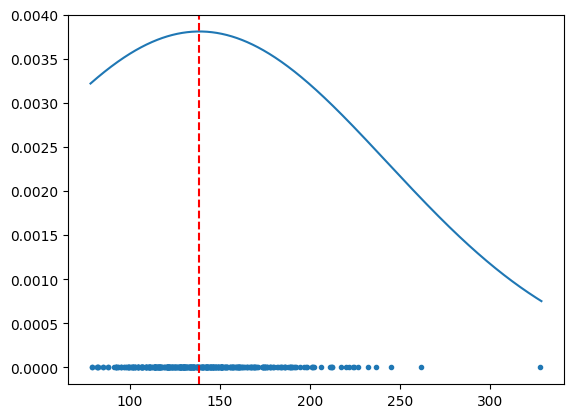

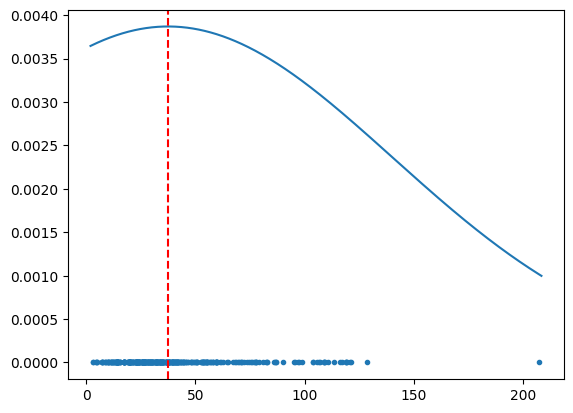

Horizontal Threshold:  138.44893992893873
Vertical Threshold:  37.53768114668767


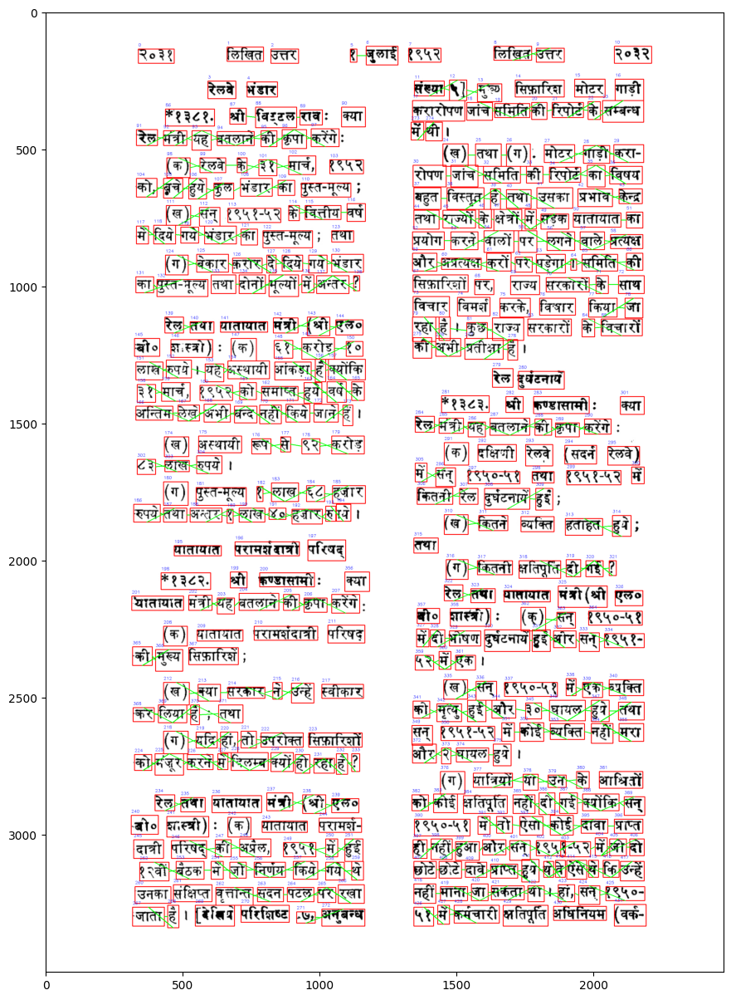

File ID:  68
Bandwidth Value:  None


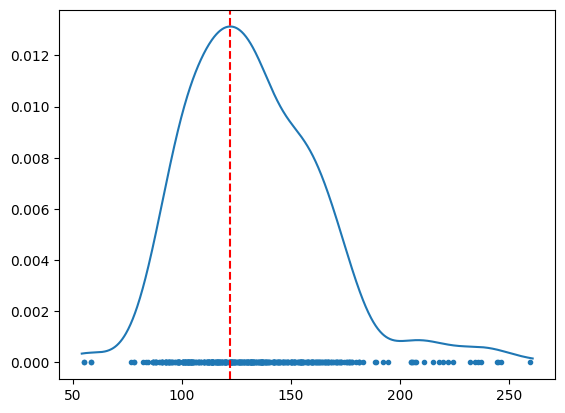

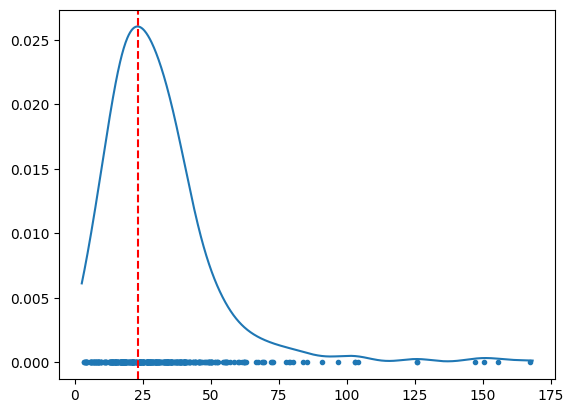

Horizontal Threshold:  122.1135191298753
Vertical Threshold:  23.17063810459785


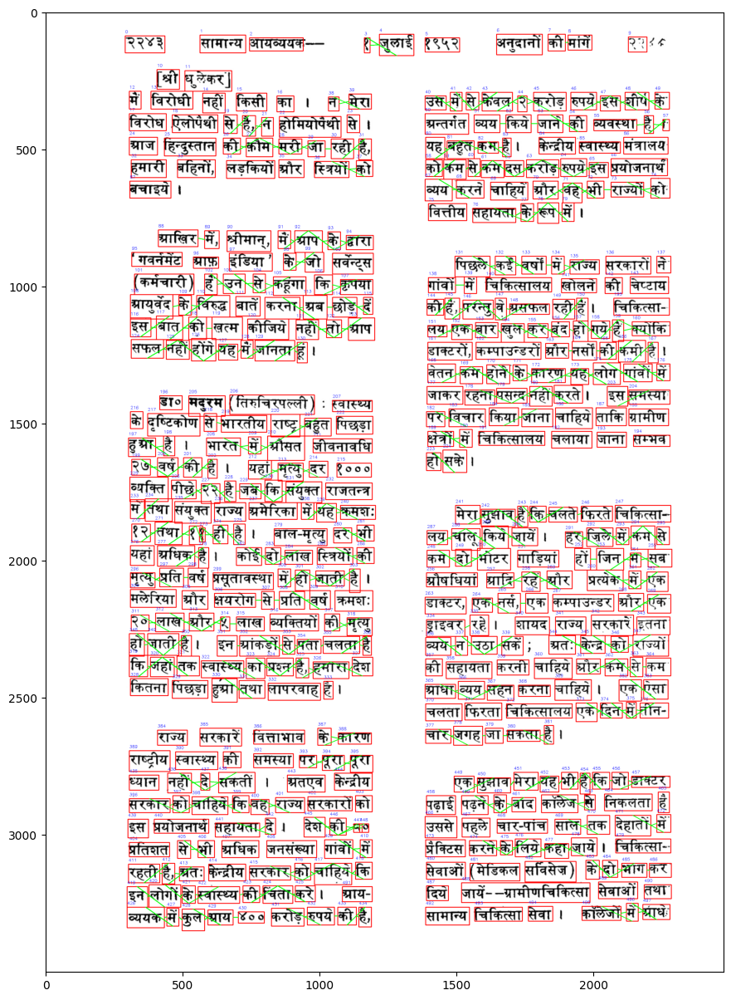

File ID:  68
Bandwidth Value:  1000


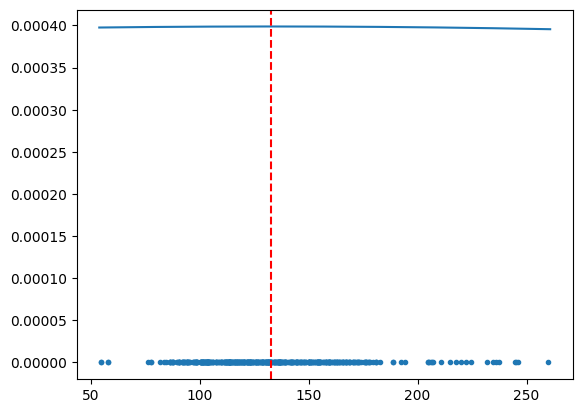

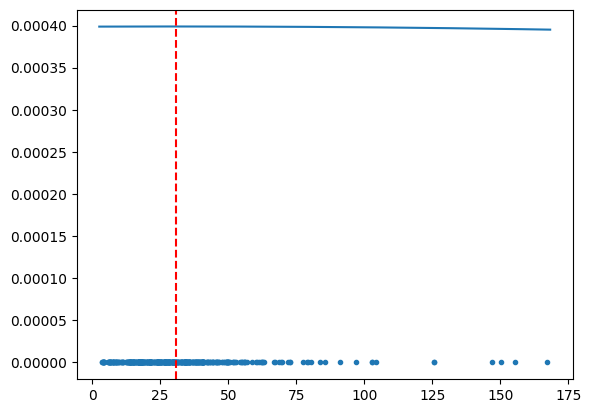

Horizontal Threshold:  132.8791817279103
Vertical Threshold:  30.633774453880296


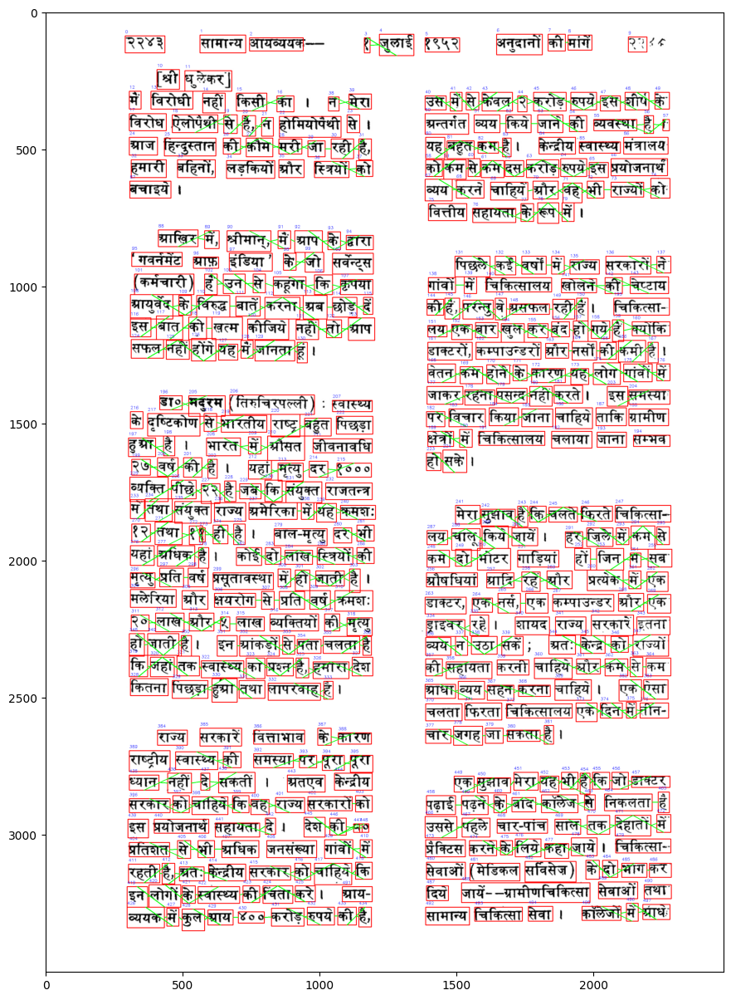

File ID:  68
Bandwidth Value:  10


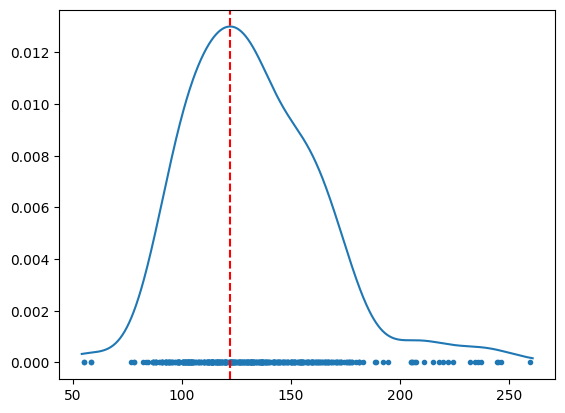

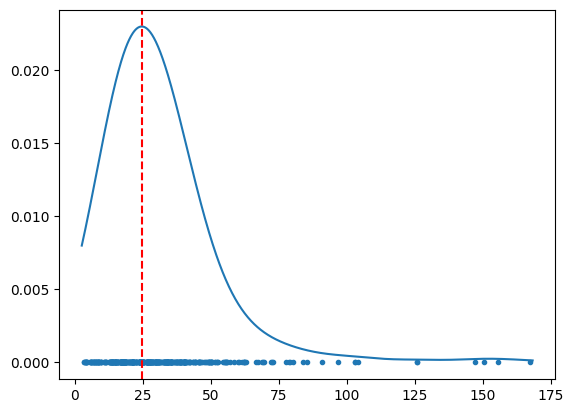

Horizontal Threshold:  122.1135191298753
Vertical Threshold:  24.663265374454337


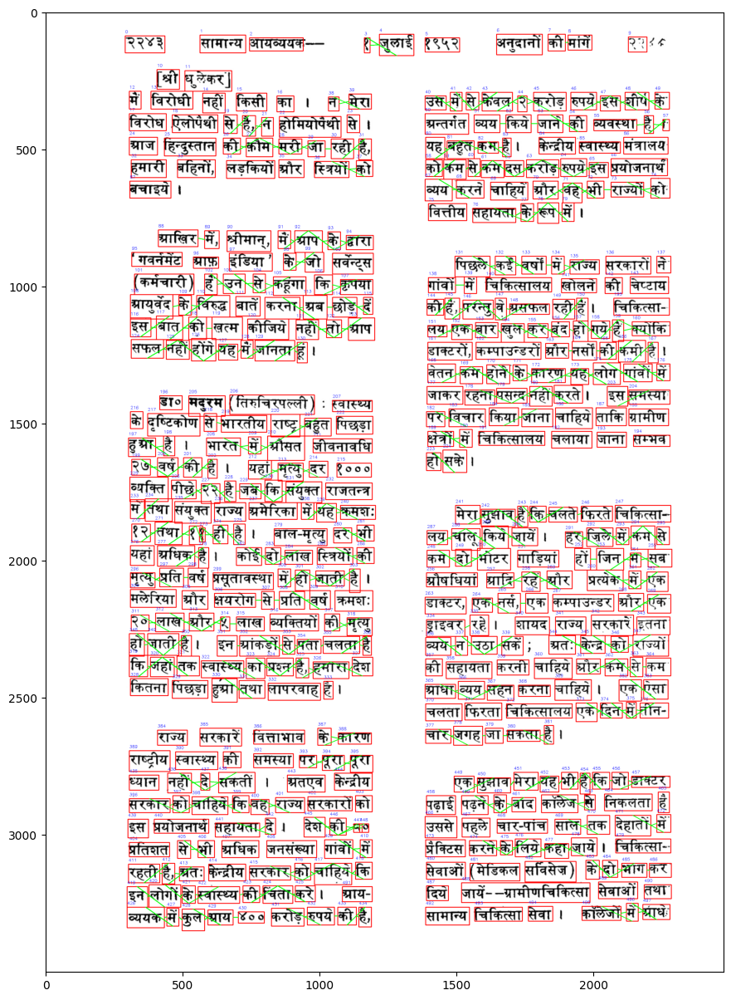

File ID:  68
Bandwidth Value:  100


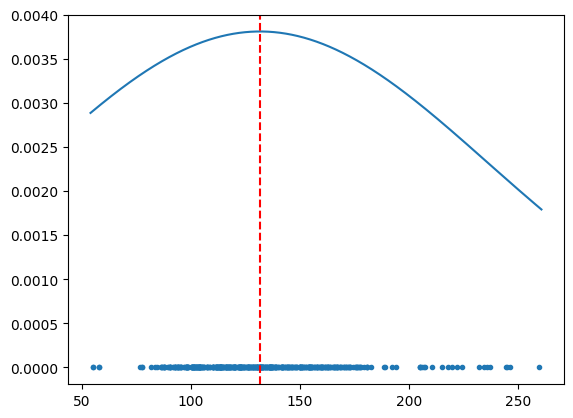

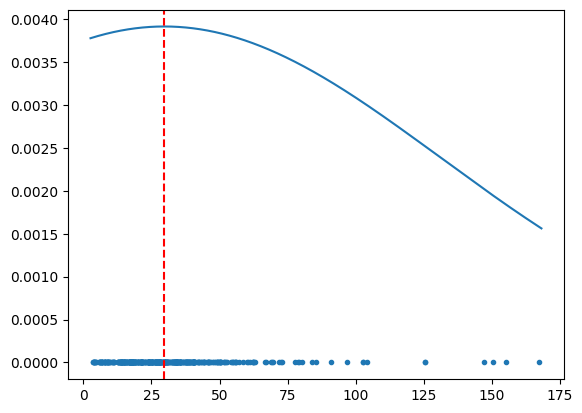

Horizontal Threshold:  131.63698988967548
Vertical Threshold:  29.638689607309303


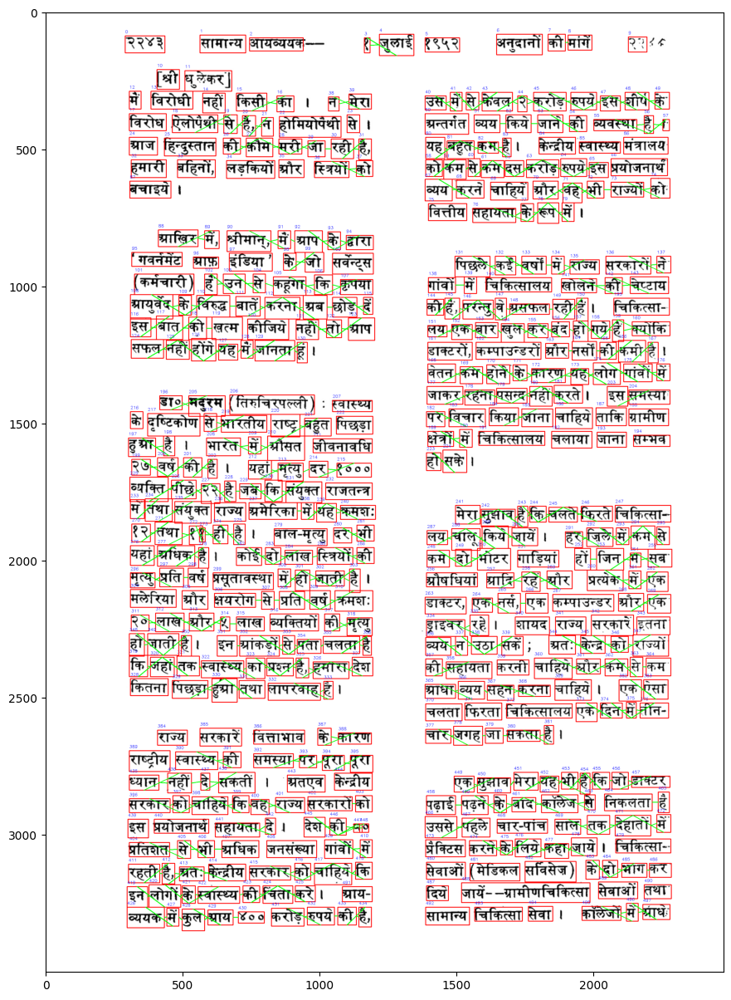

File ID:  145
Bandwidth Value:  None


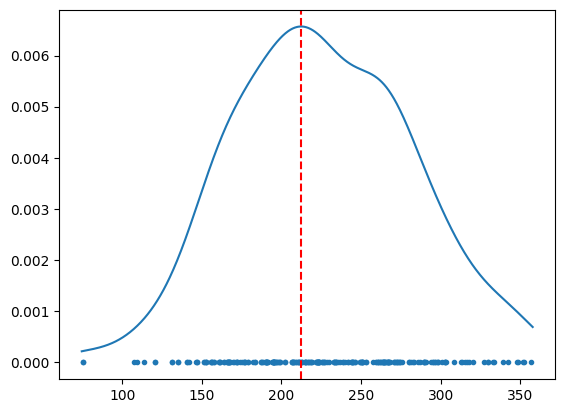

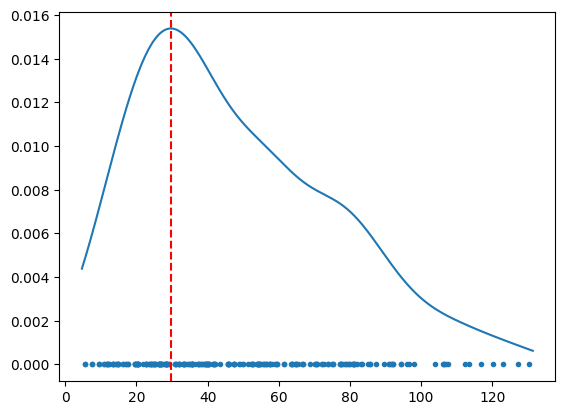

Horizontal Threshold:  212.33854147095735
Vertical Threshold:  29.65617468621136


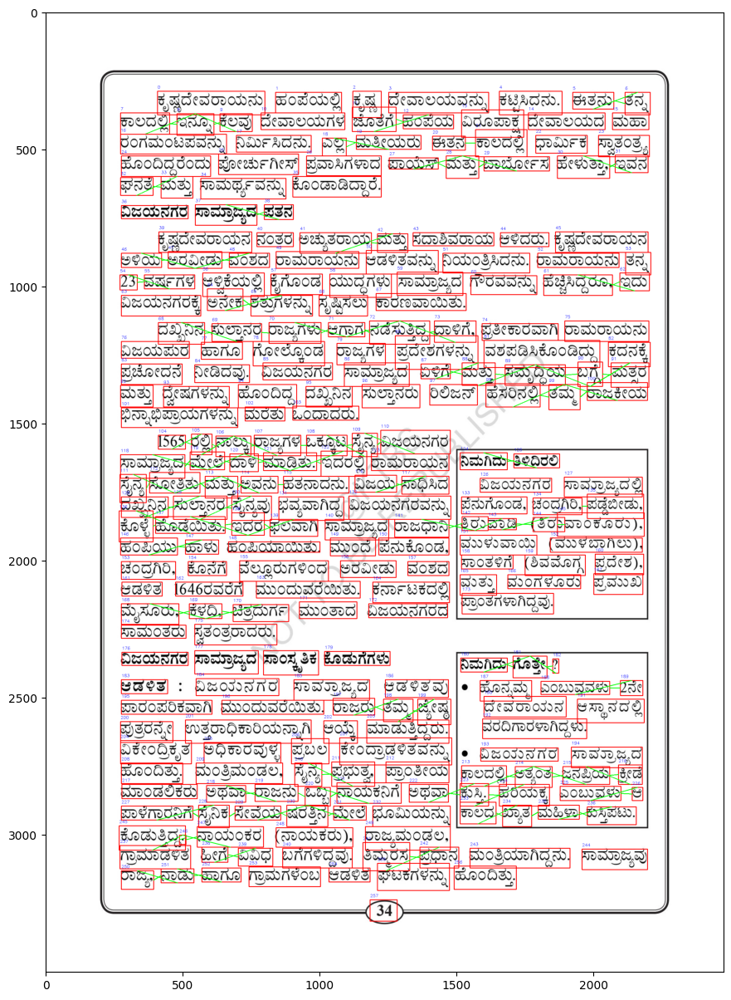

File ID:  145
Bandwidth Value:  1000


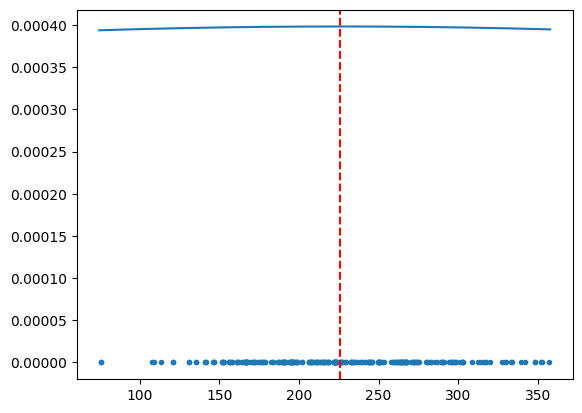

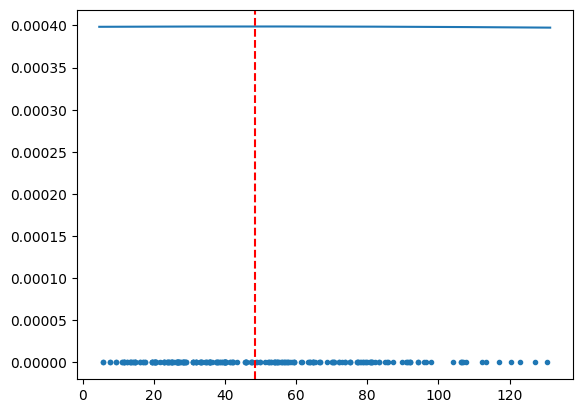

Horizontal Threshold:  225.66028508397108
Vertical Threshold:  48.31048993594584


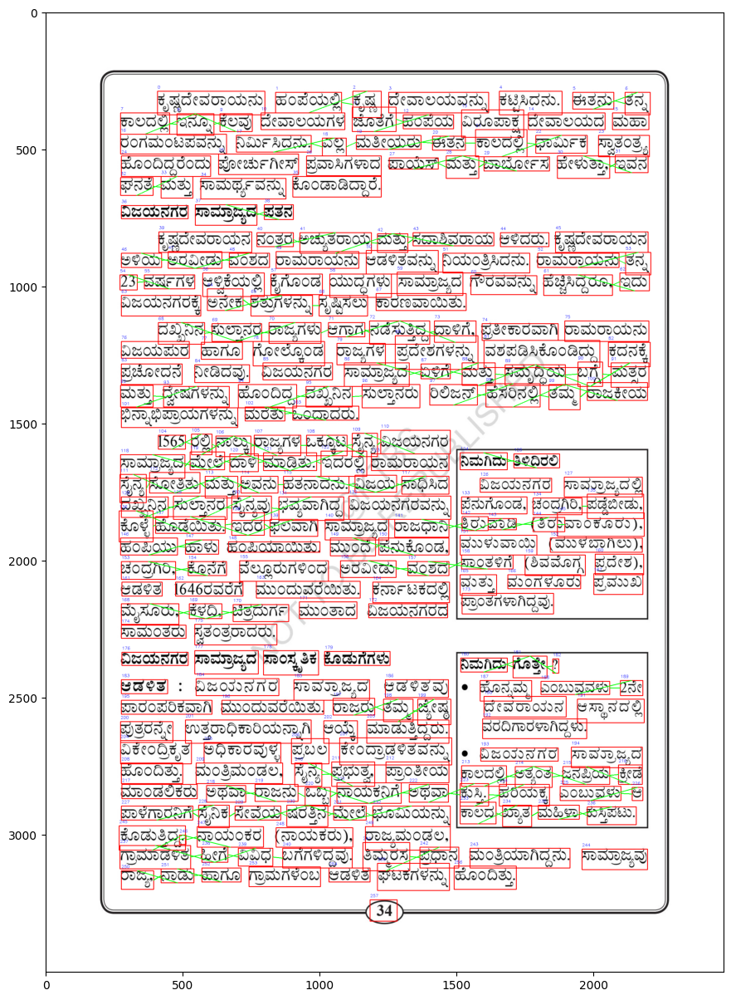

File ID:  145
Bandwidth Value:  10


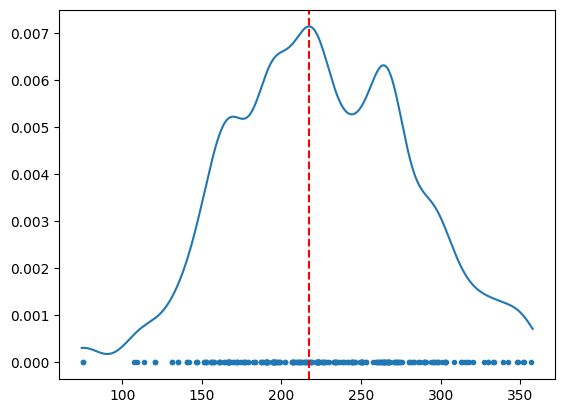

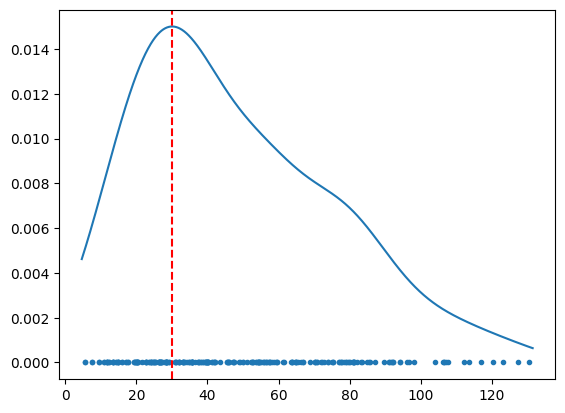

Horizontal Threshold:  217.44048583338815
Vertical Threshold:  30.036874997430434


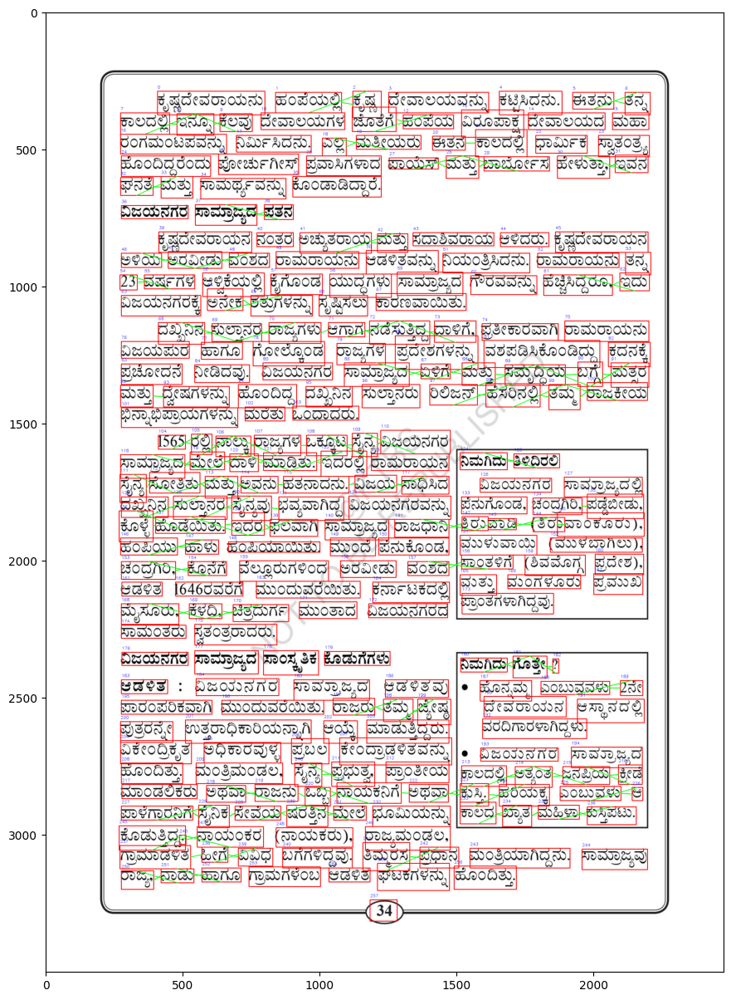

File ID:  145
Bandwidth Value:  100


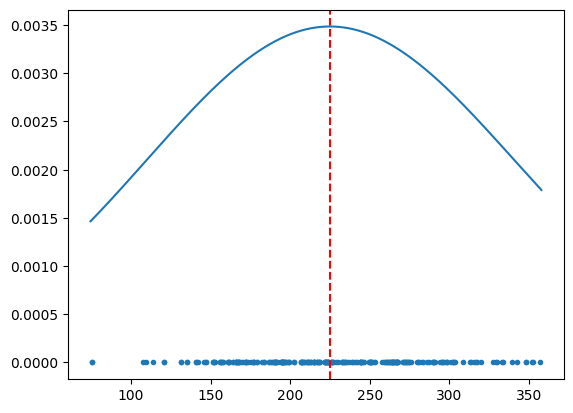

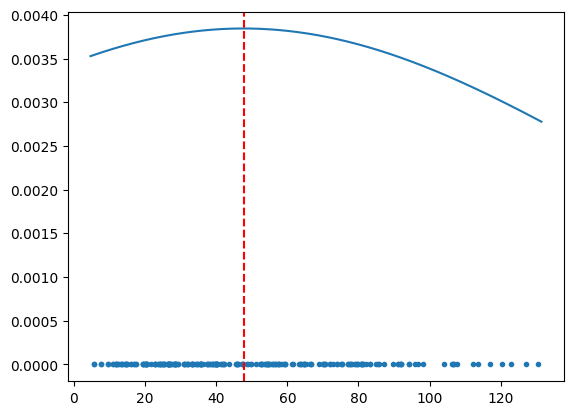

Horizontal Threshold:  224.80996102356596
Vertical Threshold:  47.675989417247386


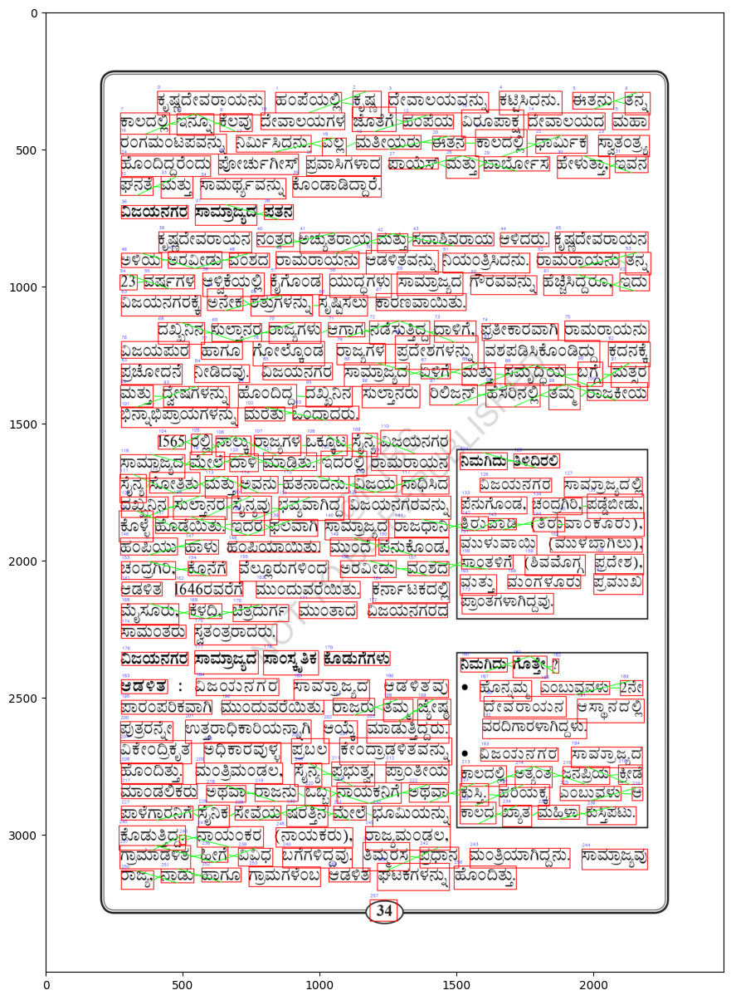

File ID:  201
Bandwidth Value:  None


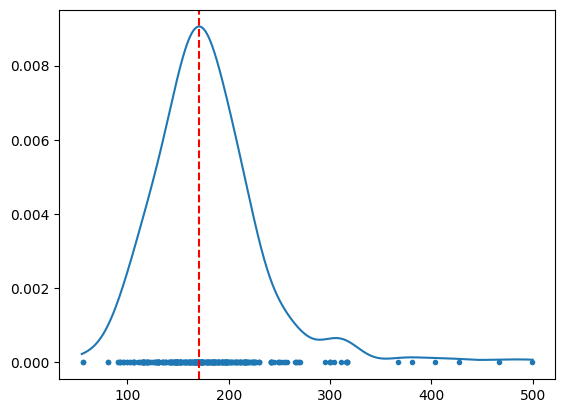

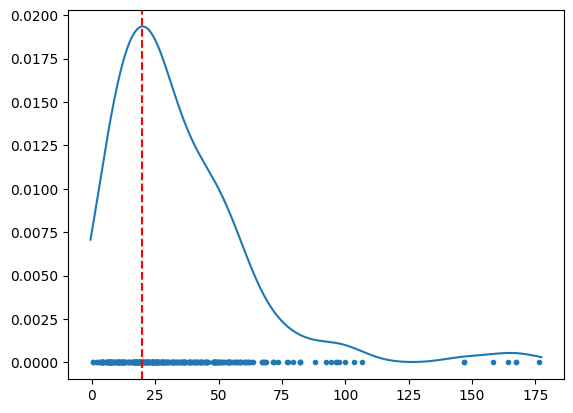

Horizontal Threshold:  170.7641463789058
Vertical Threshold:  19.977360516037432


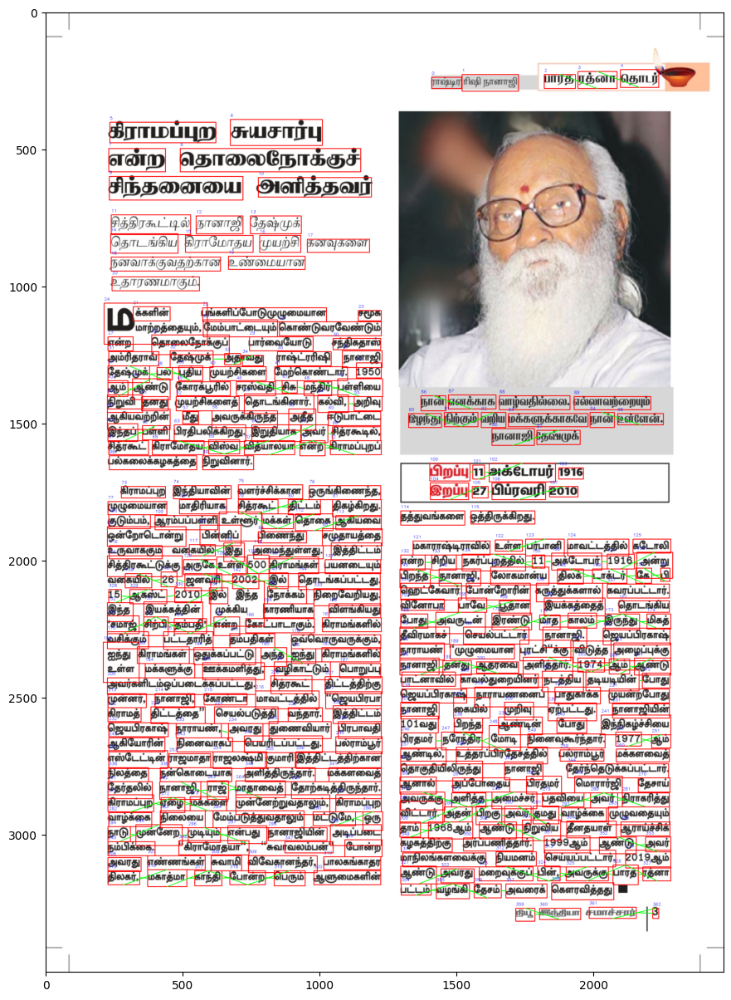

File ID:  201
Bandwidth Value:  1000


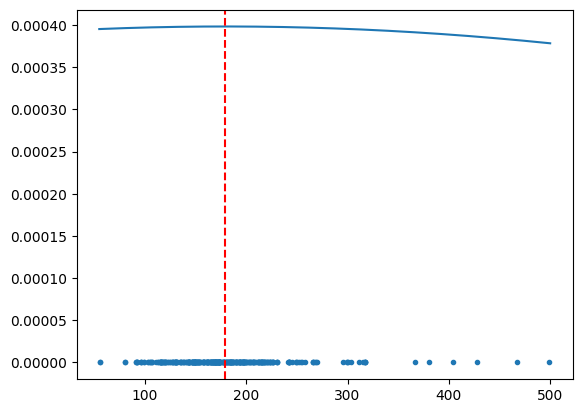

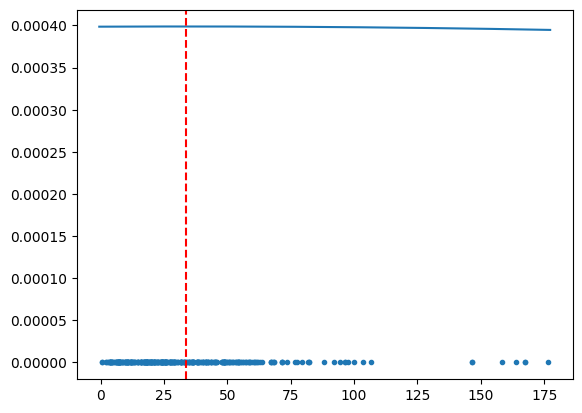

Horizontal Threshold:  179.2302005583956
Vertical Threshold:  33.86635286604543


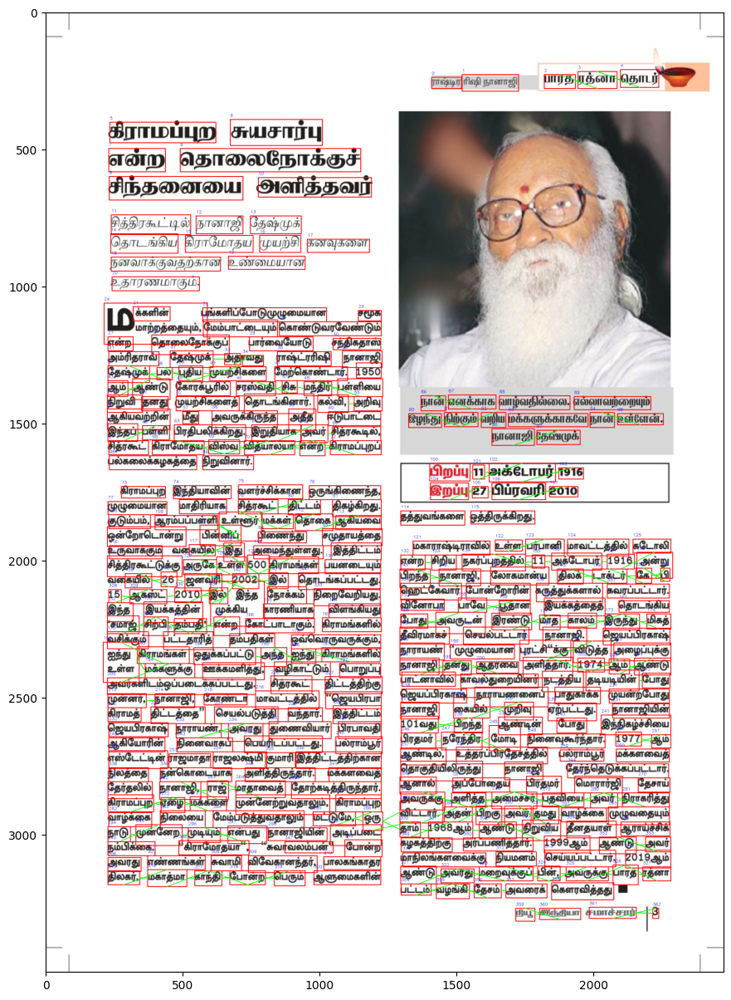

File ID:  201
Bandwidth Value:  10


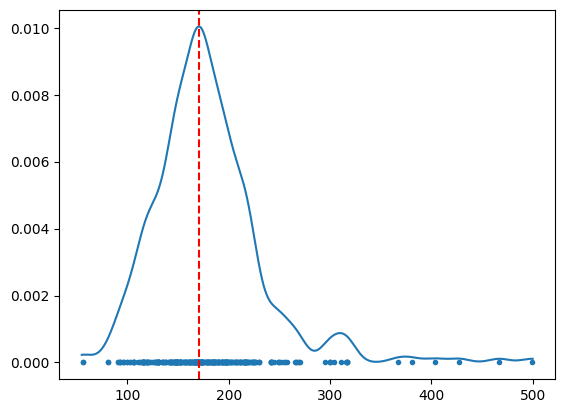

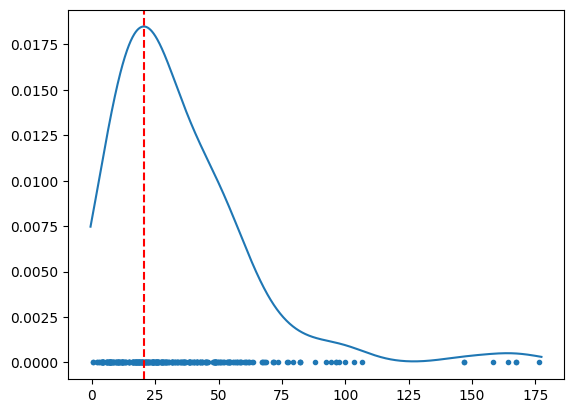

Horizontal Threshold:  170.7641463789058
Vertical Threshold:  20.511552529499276


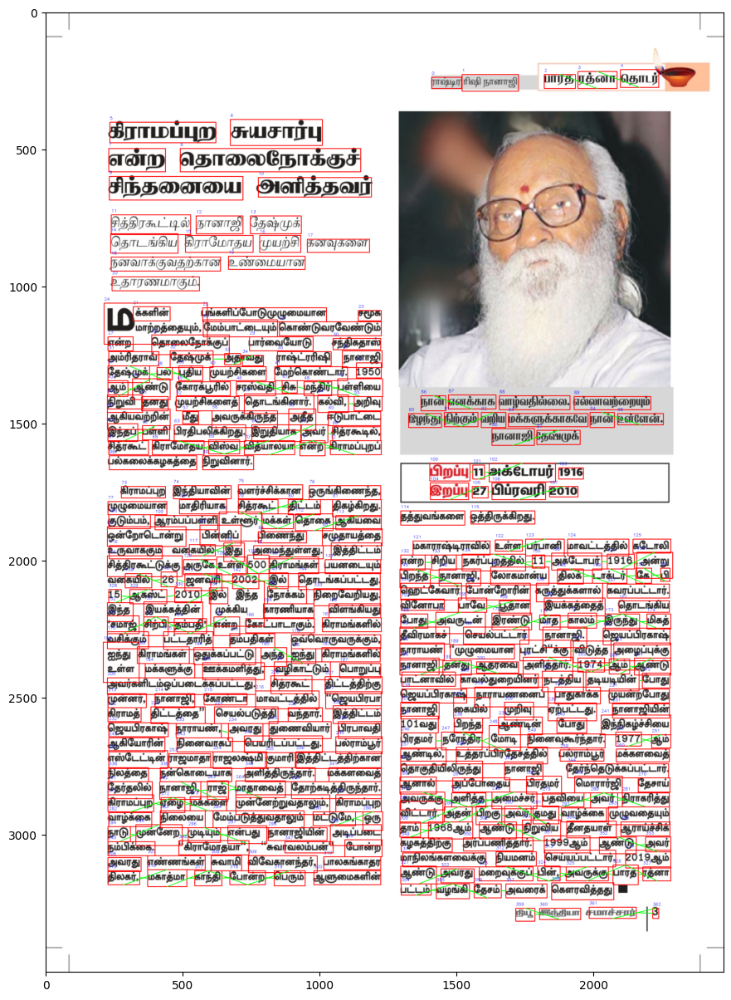

File ID:  201
Bandwidth Value:  100


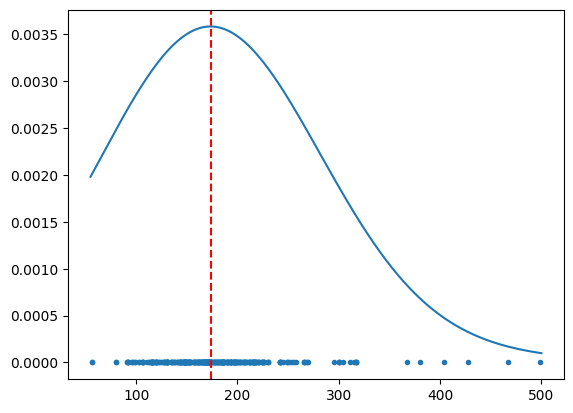

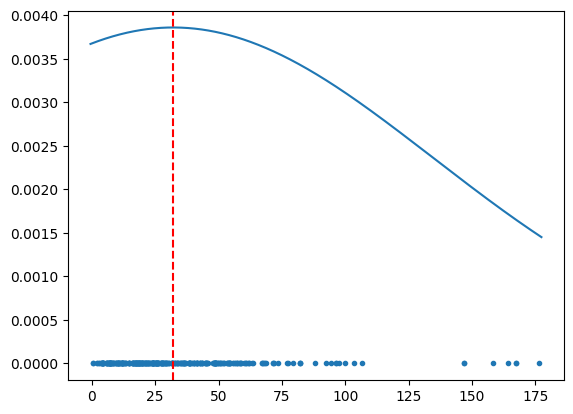

Horizontal Threshold:  173.43763717242888
Vertical Threshold:  32.085712821172606


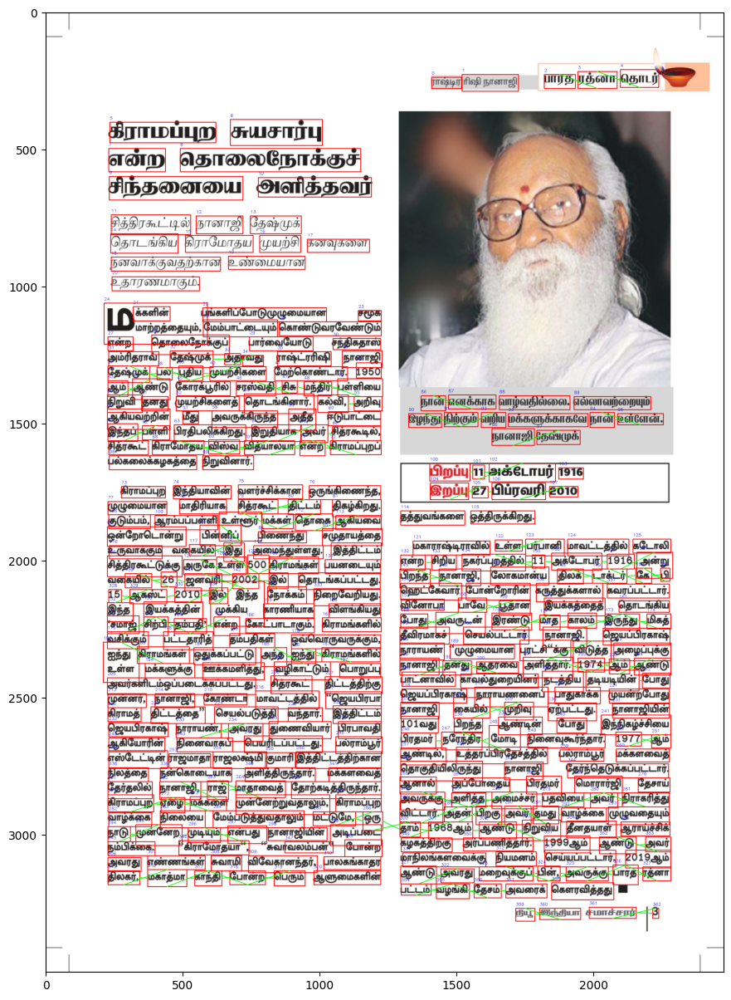

In [21]:
files = [29, 68, 145, 201]
bandwidths = [None, 1000, 10, 100]

# Iterate through each file
for file_id in files:
    # Iterate through each bandwidth value
    for bandwidth_value in bandwidths:
        # Formulate the file path
        file_path = "./SMAI - AQ2/CSV/TLBR_" + str(file_id) + ".csv"
        
        # Read data from the CSV file
        data_frame = read_data(file_path)
        
        # Calculate horizontal and vertical distances
        horizontal_distances, vertical_distances = calc_distances(data_frame)

        print("File ID: ", file_id)
        print("Bandwidth Value: ", bandwidth_value)

        # Apply thresholding to horizontal and vertical distances
        horizontal_threshold = threshold(horizontal_distances.reshape(-1, 1), bandwidth_value)
        vertical_threshold = threshold(vertical_distances.reshape(-1, 1), bandwidth_value)

        print("Horizontal Threshold: ", horizontal_threshold)
        print("Vertical Threshold: ", vertical_threshold)

        # Update connections based on the calculated thresholds
        data_frame = update_connections(data_frame, horizontal_threshold, vertical_threshold)

        # Load the image for visualization
        image_path = "./SMAI - AQ2/images/" + str(file_id) + ".jpg"
        image = cv2.imread(image_path)

        # Add bounding boxes to the image
        image_with_boxes = make_connections(image, data_frame)

        # Display the image with bounding boxes
        plt.figure(figsize=(40, 15))
        plt.imshow(image_with_boxes)
        plt.show()

In [9]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score

def make_clusters(df):
    silhouette_scores = []
    mid_points = df['Mid'].tolist()
    
    # Iterate over a range of cluster numbers
    for i in range(2, 10):
        model = AgglomerativeClustering(n_clusters=i)
        model.fit(mid_points)
        labels = model.labels_
        
        # Calculate silhouette score for each cluster configuration
        score = silhouette_score(mid_points, labels)
        silhouette_scores.append(score)
    
    # Identify the optimal number of clusters based on the highest silhouette score
    optimal_clusters = np.argmax(silhouette_scores) + 2
    model = AgglomerativeClustering(n_clusters=optimal_clusters)
    clusters = model.fit_predict(mid_points)
    
    # Assign cluster labels to the dataframe
    df['Cluster'] = clusters
    
    return df

def find_neighbours(data, row, direction):
    if data.empty:
        return [np.inf, -1]
    
    # Filter neighbors within the same cluster
    neighbors = data[(data['Id'] != row['Id']) & (data['Cluster'] == row['Cluster'])]
    
    if neighbors.empty:
        return [np.inf, -1]
    
    # Calculate distances based on specified direction
    if direction == 'Top':
        neighbors['distance'] = neighbors.apply(lambda x: np.sqrt(np.sum((np.array(x['Bottom']) - np.array(row['Top']))**2)), axis=1)
    elif direction == 'Bottom':
        neighbors['distance'] = neighbors.apply(lambda x: np.sqrt(np.sum((np.array(x['Top']) - np.array(row['Bottom']))**2)), axis=1)
    elif direction == 'Left':
        neighbors['distance'] = neighbors.apply(lambda x: np.sqrt(np.sum((np.array(x['Right']) - np.array(row['Left']))**2)), axis=1)
    elif direction == 'Right':
        neighbors['distance'] = neighbors.apply(lambda x: np.sqrt(np.sum((np.array(x['Left']) - np.array(row['Right']))**2)), axis=1)
    
    # Find the nearest neighbor
    nearest = neighbors.loc[neighbors['distance'].idxmin()]
    return [nearest['distance'], nearest['Id']]

def update_neighbours(data):
    directions = ['Top', 'Bottom', 'Left', 'Right']

    # Iterate over directions and update neighbor information
    for direction in directions:
        data[direction + '_Box'] = data.apply(lambda row: find_neighbours(data, row, direction), axis=1)

    return data

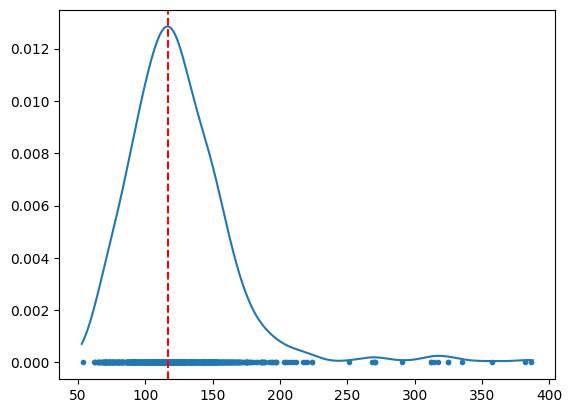

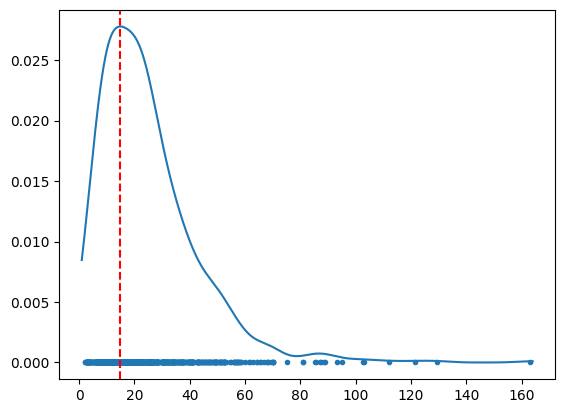

Horizontal Threshold:  116.44592678430334
Vertical Threshold:  14.868868868868867


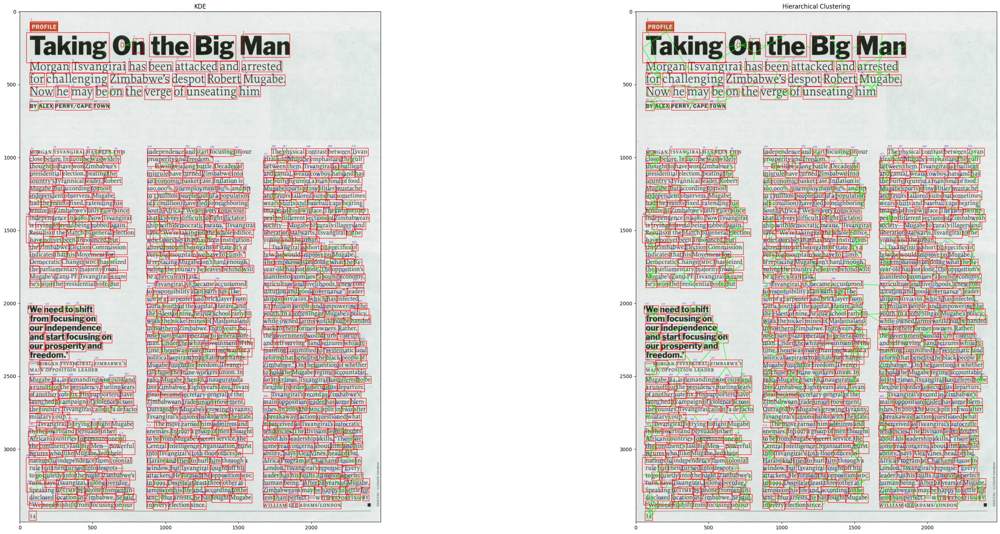

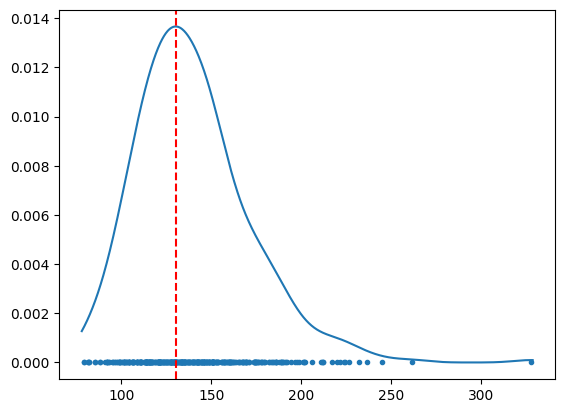

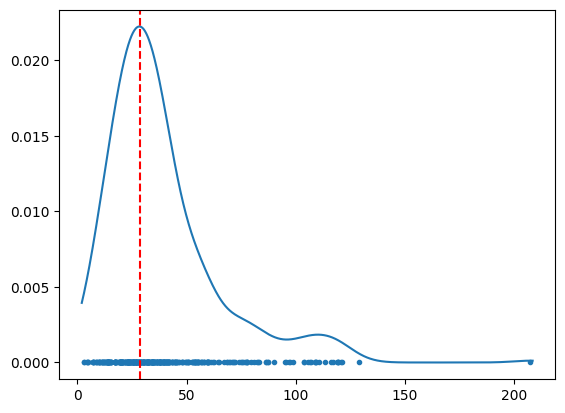

Horizontal Threshold:  130.17516520513055
Vertical Threshold:  28.44664643474431


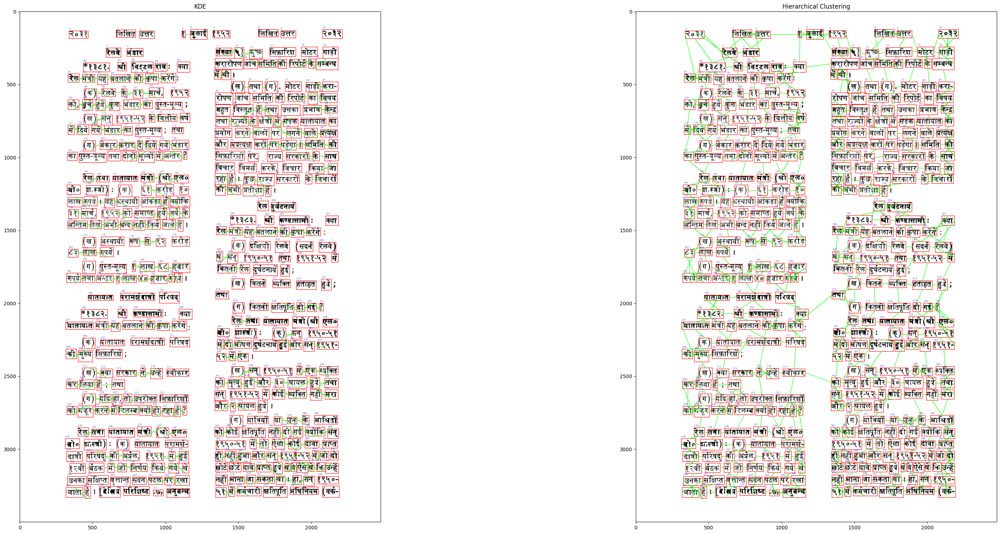

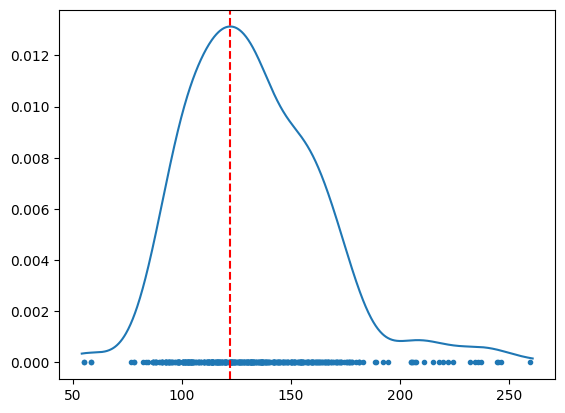

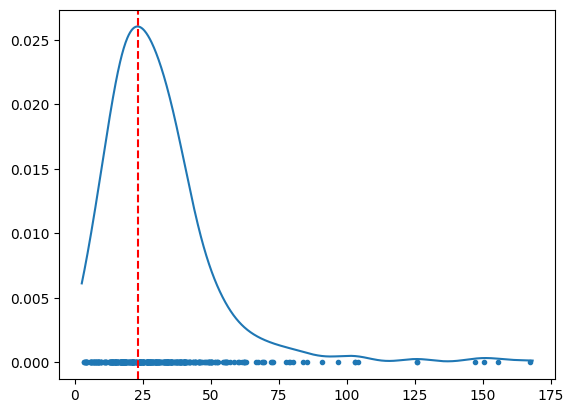

Horizontal Threshold:  122.1135191298753
Vertical Threshold:  23.17063810459785


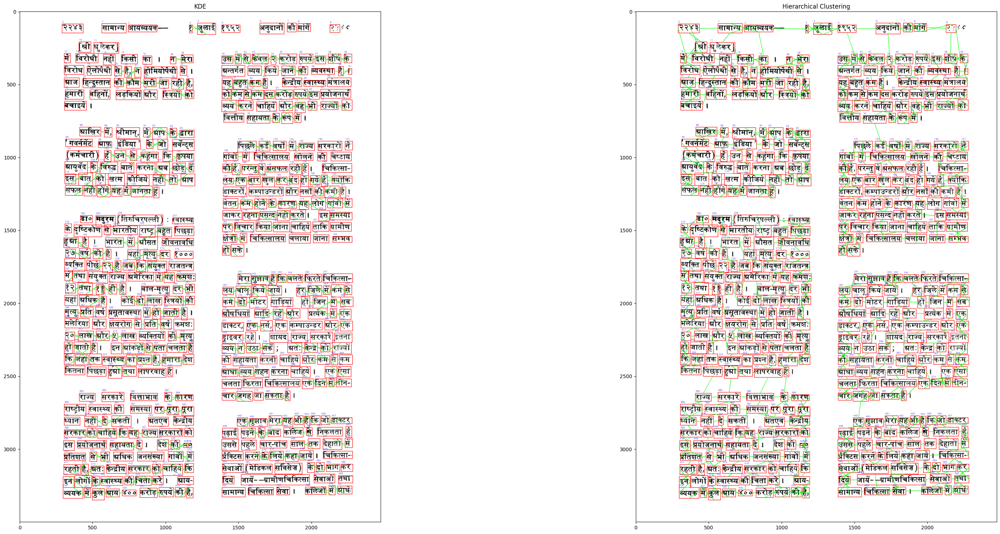

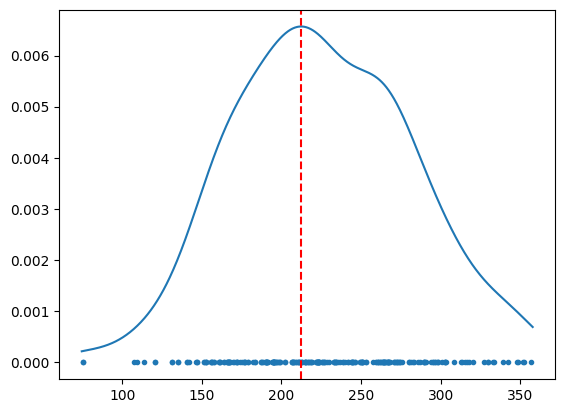

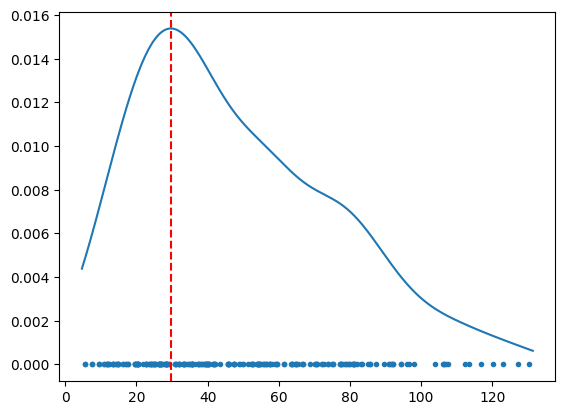

Horizontal Threshold:  212.33854147095735
Vertical Threshold:  29.65617468621136


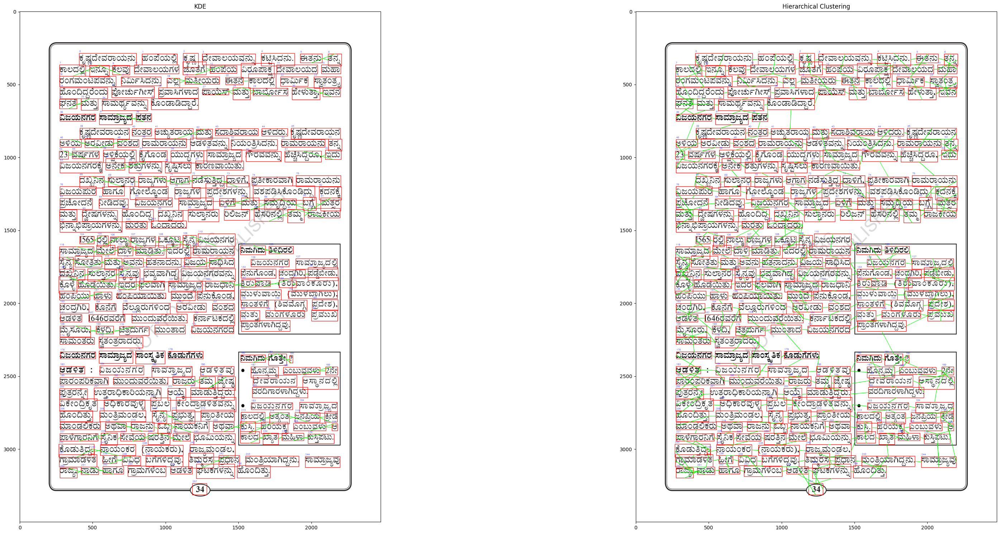

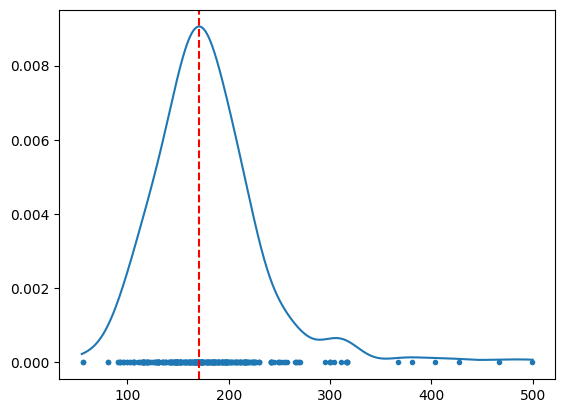

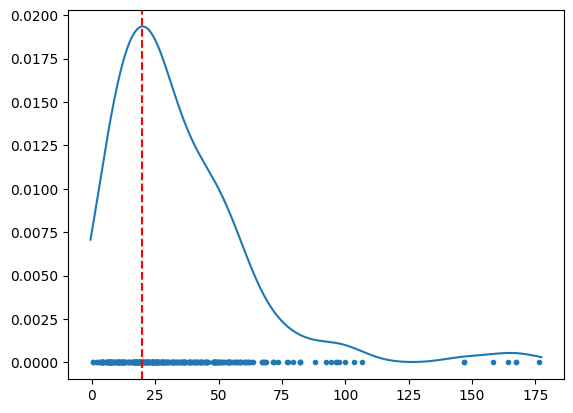

Horizontal Threshold:  170.7641463789058
Vertical Threshold:  19.977360516037432


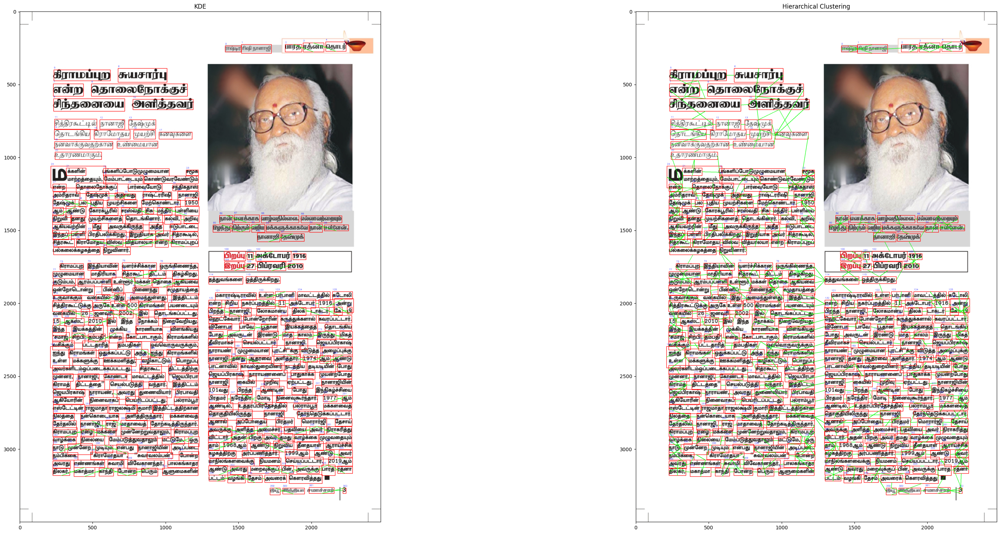

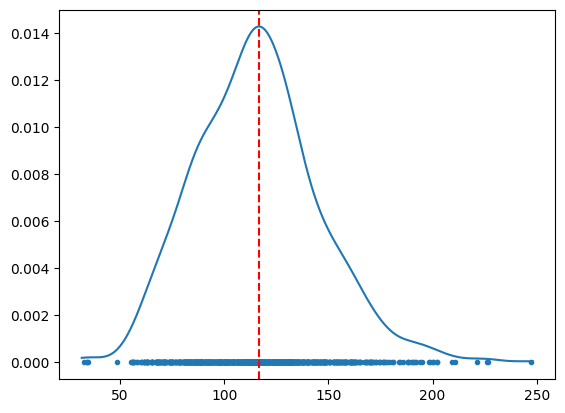

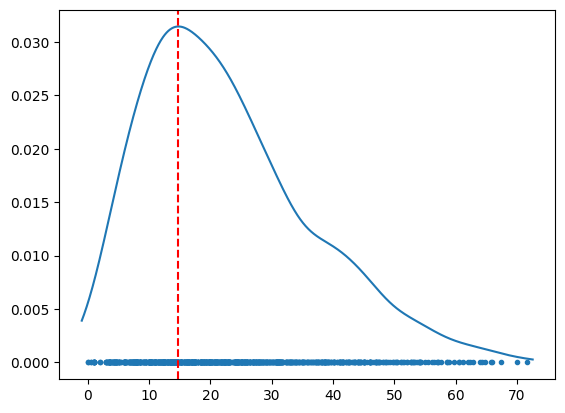

Horizontal Threshold:  116.7382748622297
Vertical Threshold:  14.763832370075773


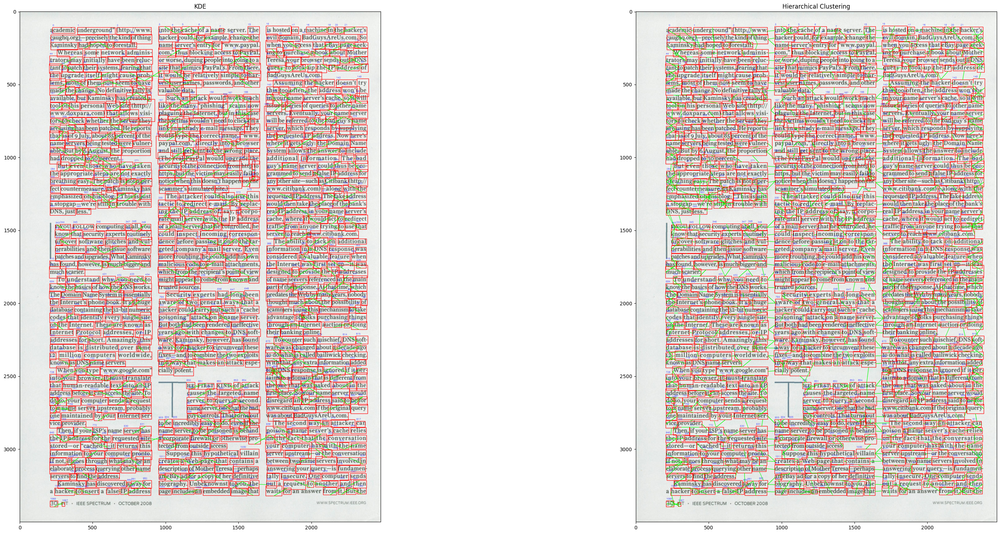

In [10]:
files = [232, 29, 68, 145, 201,  250]

# Iterate through a list of file names
for file in files:
    # Construct the file path
    path = "./SMAI - AQ2/CSV/TLBR_" + str(file) + ".csv"
    
    # Read data from the CSV file
    df = read_data(path)
    
    # Calculate horizontal and vertical distances from the data
    horizontal_dist, vertical_dist = calc_distances(df)
    
    # Apply thresholding to the distances
    hr_threshold = threshold(horizontal_dist.reshape(-1, 1))
    vr_threshold = threshold(vertical_dist.reshape(-1, 1))

    # Print the obtained thresholds
    print("Horizontal Threshold: ", hr_threshold)
    print("Vertical Threshold: ", vr_threshold)
    
    # Update connections in the dataframe based on the thresholds
    df = update_connections(df, hr_threshold, vr_threshold)
    
    # Construct the image path
    img_path = "./SMAI - AQ2/images/" + str(file) + ".jpg"
    
    # Generate an image with connections using Kernel Density Estimation (KDE)
    img_kde = make_connections(cv2.imread(img_path), df)

    # Make clusters, update neighbors, and generate an image with connections using Hierarchical Clustering (HC)
    df = make_clusters(df)
    df = update_neighbours(df)
    img_hc = make_connections(cv2.imread(img_path), df)

    # Display the images side by side
    fig, axs = plt.subplots(1, 2, figsize=(40, 15))
    axs[0].imshow(img_kde)
    axs[0].set_title("KDE")
    axs[1].imshow(img_hc)
    axs[1].set_title("Hierarchical Clustering")

    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()